In [1]:
import pandas as pd
import numpy as np
import sklearn as sl
import seaborn as sns
import matplotlib.pyplot as plt
np.random.seed(23)

<h1>First look at the dataset</h1>

In [2]:
houses_df = pd.read_csv("C:\mojepliki\PW\HousePriceIndia.csv")

In [ ]:
houses_df.head()

In [ ]:
houses_df.info()

In [ ]:
houses_df.describe()

<h1>Defining classification</h1>

In [3]:
target_variable = "Price"
houses_df["Price"].describe()


count    1.462000e+04
mean     5.389322e+05
std      3.675324e+05
min      7.800000e+04
25%      3.200000e+05
50%      4.500000e+05
75%      6.450000e+05
max      7.700000e+06
Name: Price, dtype: float64

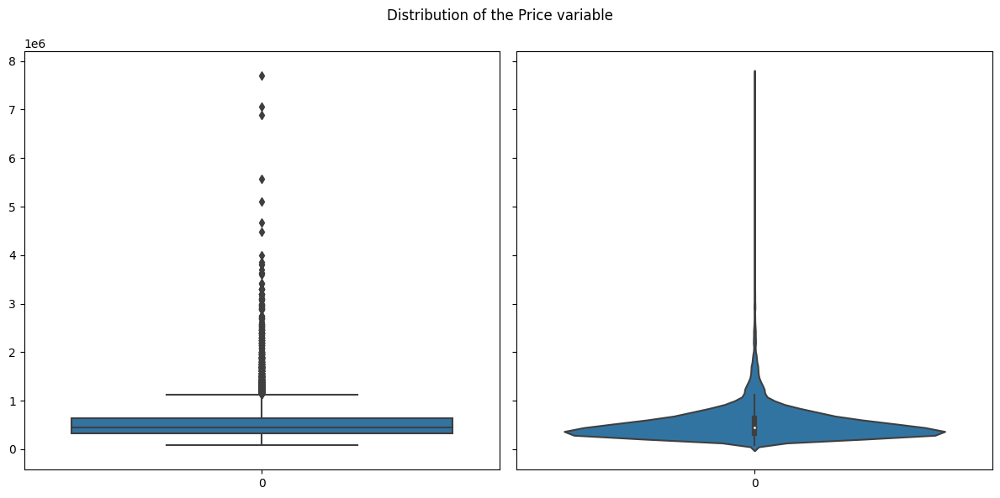

In [8]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
fig.suptitle("Distribution of the Price variable")

sns.boxplot(data=houses_df["Price"], ax=axes[0])
sns.violinplot(data=houses_df["Price"], ax=axes[1])

plt.tight_layout()
plt.show()

In [3]:
prices = houses_df["Price"]

q1 = np.percentile(prices, 25)
q3 = np.percentile(prices, 75)

iqr = q3 - q1
print(f"iqr: {iqr}")


lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
print(f"lower bound: {lower_bound}")
print(f"upper bound: {upper_bound}")

iqr: 325000.0
lower bound: -167500.0
upper bound: 1132500.0


In [4]:
lower_bound = max(0, lower_bound)

In [5]:
threshold1 = lower_bound + (upper_bound - lower_bound) / 3
threshold2 = lower_bound + (upper_bound - lower_bound) / 3 * 2

print(f"threshold 1: {threshold1}")
print(f"threshold 2: {threshold2}")

threshold 1: 377500.0
threshold 2: 755000.0


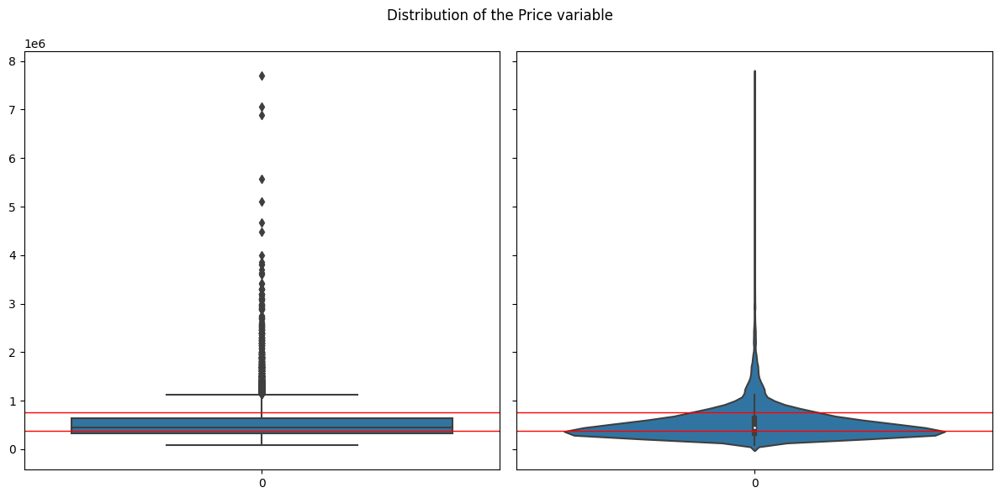

In [12]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharey=True)
fig.suptitle("Distribution of the Price variable")

sns.boxplot(data=houses_df["Price"], ax=axes[0])
sns.violinplot(data=houses_df["Price"], ax=axes[1])
axes[0].axhline(y=threshold1, color='red', linestyle='-', linewidth=1)
axes[1].axhline(y=threshold1, color='red', linestyle='-', linewidth=1)
axes[0].axhline(y=threshold2, color='red', linestyle='-', linewidth=1)
axes[1].axhline(y=threshold2, color='red', linestyle='-', linewidth=1)

plt.tight_layout()
plt.show()

In [6]:
labels = [0,1, 2]
bins = [-float("inf"), threshold1, threshold2, float("inf")]
houses_df["price_category"] = pd.cut(houses_df["Price"], bins=bins, labels=labels, include_lowest=True)

houses_df.head(10)

,id,Date,number of bedrooms,number of bathrooms,living area,lot area,number of floors,waterfront present,number of views,condition of the house,...,Renovation Year,Postal Code,Lattitude,Longitude,living_area_renov,lot_area_renov,Number of schools nearby,Distance from the airport,Price,price_category
0,6762810145,42491,5,2.50,3650,9050,2.0,0,4,5,...,0,122003,52.8645,-114.557,2880,5400,2,58,2380000,2
1,6762810635,42491,4,2.50,2920,4000,1.5,0,0,5,...,0,122004,52.8878,-114.470,2470,4000,2,51,1400000,2
2,6762810998,42491,5,2.75,2910,9480,1.5,0,0,3,...,0,122004,52.8852,-114.468,2940,6600,1,53,1200000,2
3,6762812605,42491,4,2.50,3310,42998,2.0,0,0,3,...,0,122005,52.9532,-114.321,3350,42847,3,76,838000,2
4,6762812919,42491,3,2.00,2710,4500,1.5,0,0,4,...,0,122006,52.9047,-114.485,2060,4500,1,51,805000,2
5,6762813105,42491,3,2.50,2600,4750,1.0,0,0,4,...,0,122007,52.9133,-114.590,2380,4750,1,67,790000,2
6,6762813157,42491,5,3.25,3660,11995,2.0,0,2,3,...,0,122008,52.7637,-114.050,3320,11241,3,72,785000,2
7,6762813599,42491,3,1.75,2240,10578,2.0,0,0,5,...,0,122006,52.9254,-114.482,1570,10578,3,71,750000,1
8,6762813600,42491,3,2.50,2390,6550,1.0,0,2,4,...,0,122009,52.8014,-114.598,2010,6550,1,73,750000,1
9,6762814461,42491,4,2.25,2200,11250,1.5,0,0,5,...,0,122010,52.9145,-114.391,2320,10814,2,53,698000,1


In [14]:
category_counts = houses_df['price_category'].value_counts()
print(category_counts)
print()
houses_df.info()


price_category
Medium       6912
Cheap        5307
Expensive    2401
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14620 entries, 0 to 14619
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype   
---  ------                                 --------------  -----   
 0   id                                     14620 non-null  int64   
 1   Date                                   14620 non-null  int64   
 2   number of bedrooms                     14620 non-null  int64   
 3   number of bathrooms                    14620 non-null  float64 
 4   living area                            14620 non-null  int64   
 5   lot area                               14620 non-null  int64   
 6   number of floors                       14620 non-null  float64 
 7   waterfront present                     14620 non-null  int64   
 8   number of views                        14620 non-null  int64   
 9   condition of the house         

<AxesSubplot: xlabel='price_category'>

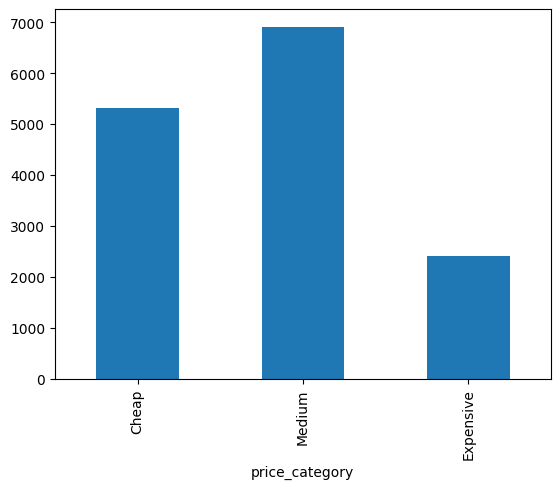

In [15]:
category_order = ["Cheap", "Medium", "Expensive"]
pd.Series(houses_df["price_category"]).value_counts().loc[category_order].plot(kind="bar")

<AxesSubplot: xlabel='id', ylabel='Price'>

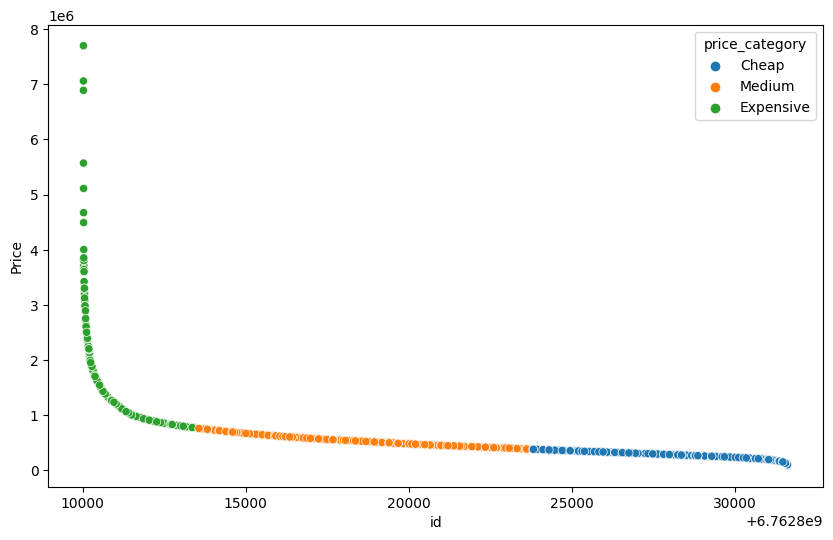

In [16]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=houses_df, x="id", y="Price", hue="price_category")

<h1>Creation of the training set, validation set and testing set</h1>

In [7]:
from sklearn.model_selection import train_test_split
y = np.array(houses_df['price_category'])
X = houses_df.drop(['price_category'],axis=1)

X_used, X_test, y_used, y_test = train_test_split(
    X, y, stratify=y, test_size=0.2, random_state=42
)

X_train, X_val, y_train, y_val = train_test_split(
    X_used, y_used, stratify=y_used, test_size=1/8, random_state=42
)

y_used = pd.DataFrame(y_used, columns=['price_category'])

print(f"all data: {X.shape}\nused in the training process: {X_used.shape}\nused for training: {X_train.shape}\nused for validation: {X_val.shape}\nused for final testing: {X_test.shape}")

train_df = X_train
train_df["price_category"] = pd.cut(train_df["Price"], bins=bins, labels=labels, include_lowest=True)

all data: (14620, 23)
used in the training process: (11696, 23)
used for training: (10234, 23)
used for validation: (1462, 23)
used for final testing: (2924, 23)


<h1>Exploratory data analysis</h1>

<h5>Correlation between variables in the training portion of the dataset</h5>

<AxesSubplot: >

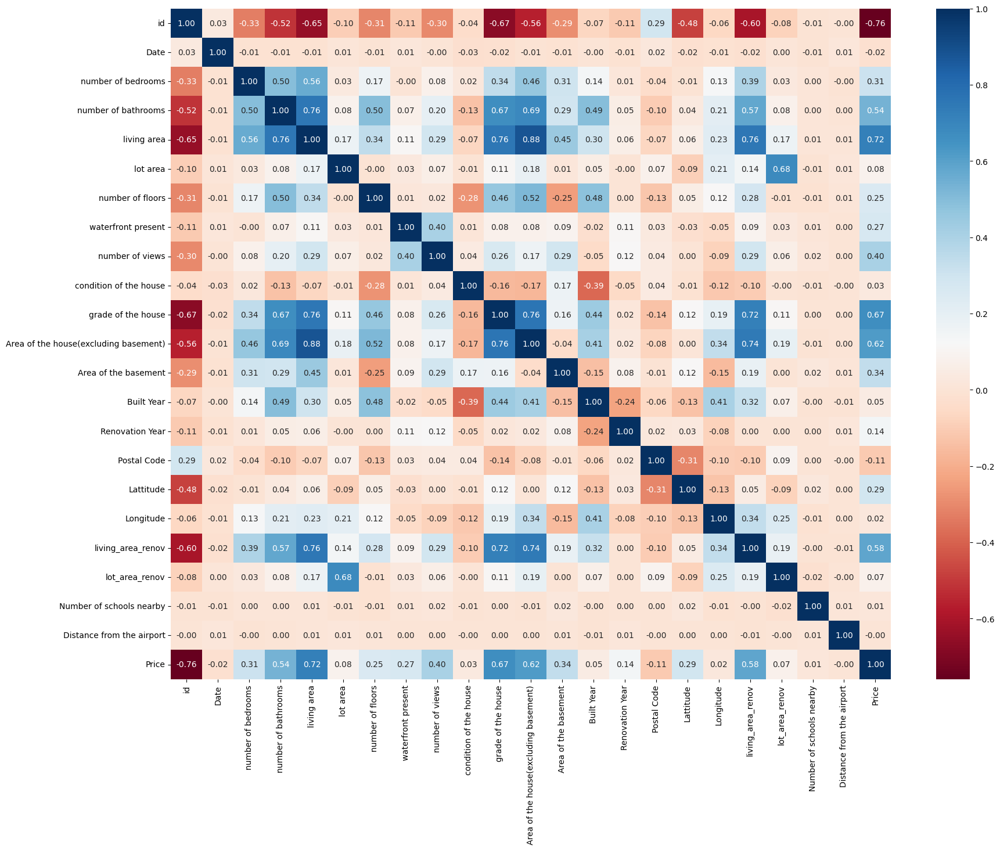

In [18]:
num_cols = train_df.select_dtypes(include=np.number).columns.to_list()
corr = train_df[num_cols].corr()

plt.figure(figsize=(20, 15))
sns.heatmap(corr, annot=True, fmt=".2f", cmap="RdBu")

<h5>Variables that correlate with "Price"</h5>

![corelation_marked](corelation_marked.png)

<h5>Substantial correlation between theese variables</h5>

![corelation_marked](corelation_marked2.png)

In [9]:
import warnings
warnings.filterwarnings("ignore", message="The default of observed=False is deprecated")
warnings.filterwarnings("ignore", message="use_inf_as_na option is deprecated and will be removed in a future version")

<h1>Distribution of variables in classes</h1>

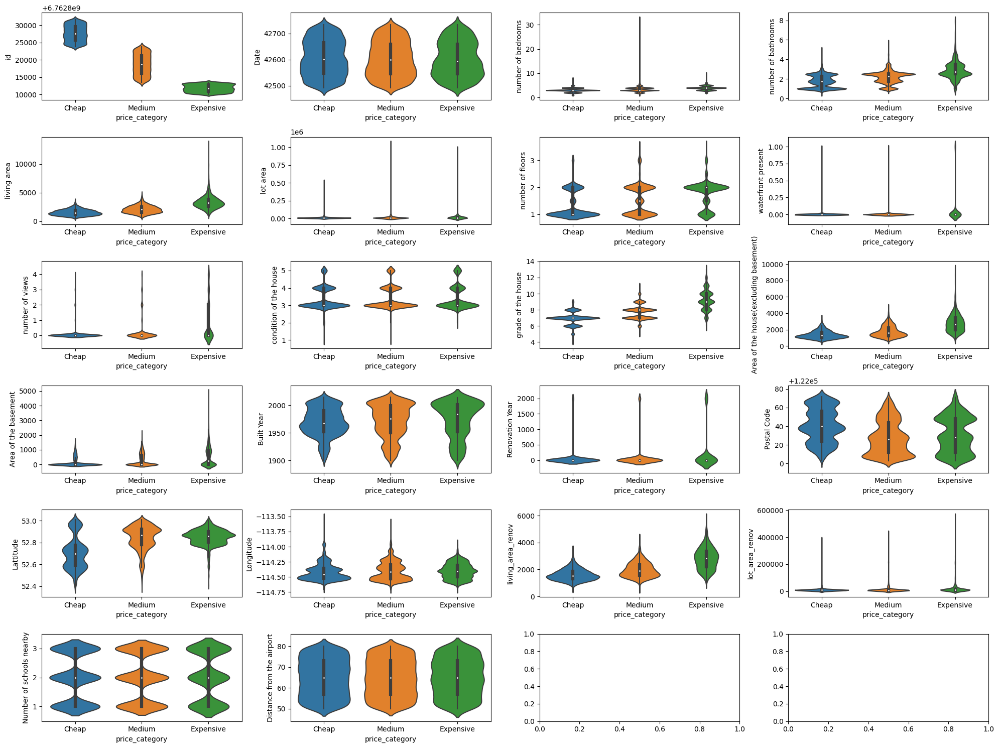

In [20]:
fig, axs = plt.subplots(6,4, figsize=(20,15))
axs = axs.flatten()
for i,col in enumerate(train_df.columns[0:22]):
    sns.violinplot(data=train_df, x=train_df["price_category"], y=col, ax=axs[i])
plt.tight_layout()

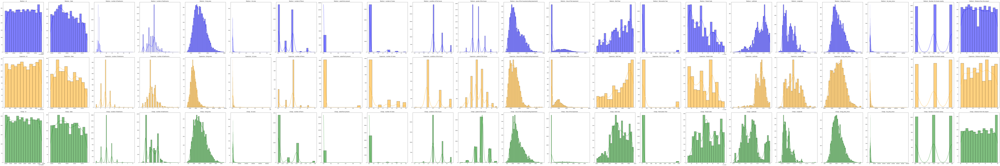

In [21]:
classes = train_df['price_category'].unique()
fig, axs = plt.subplots(3, 22, figsize=(150, 25))
colors=['blue', 'orange', 'green']
for i, clazz in enumerate(classes):
    for j, col in enumerate(train_df.columns[0:22]):
        sns.histplot(train_df[train_df['price_category'] == clazz][col], ax=axs[i, j], color=colors[i], label=clazz, kde=True)
        axs[i, j].set_title(f'{clazz} - {col}')
        axs[i, j].set_xlabel('')
        axs[i, j].set_ylabel('')
        axs[i, j].legend().remove()

axs = axs.flatten()
plt.tight_layout()

<h3>What to do with indexes</h3>

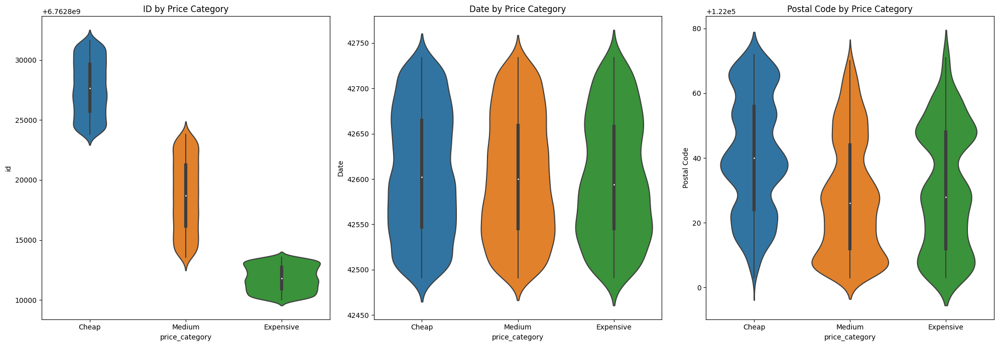

In [39]:
fig, axs = plt.subplots(1,3, figsize=(20,7))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["id"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Date"], ax=axs[1])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Postal Code"], ax=axs[2])
axs[0].set_title('ID by Price Category')
axs[1].set_title('Date by Price Category')
axs[2].set_title('Postal Code by Price Category')

plt.tight_layout()

<h3>What can be helpful?</h3>

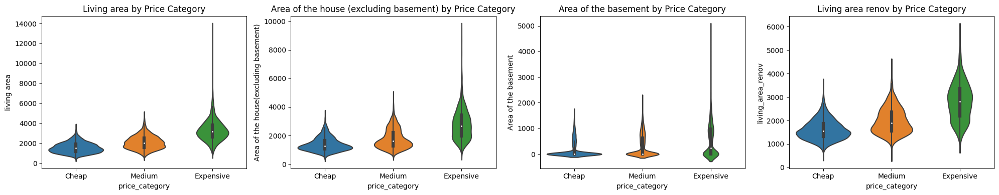

In [30]:
fig, axs = plt.subplots(1,4, figsize=(20,4))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["living area"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Area of the house(excluding basement)"], ax=axs[1])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Area of the basement"], ax=axs[2])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["living_area_renov"], ax=axs[3])
axs[0].set_title('Living area by Price Category')
axs[1].set_title('Area of the house (excluding basement) by Price Category')
axs[2].set_title('Area of the basement by Price Category')
axs[3].set_title('Living area renov by Price Category')

plt.tight_layout()

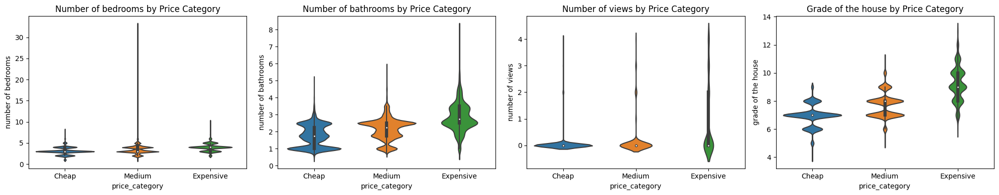

In [32]:
fig, axs = plt.subplots(1,4, figsize=(20,4))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["number of bedrooms"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["number of bathrooms"], ax=axs[1])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["number of views"], ax=axs[2])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["grade of the house"], ax=axs[3])
axs[0].set_title('Number of bedrooms by Price Category')
axs[1].set_title('Number of bathrooms by Price Category')
axs[2].set_title('Number of views by Price Category')
axs[3].set_title('Grade of the house by Price Category')

plt.tight_layout()

<h3>What does not help at all?</h3>

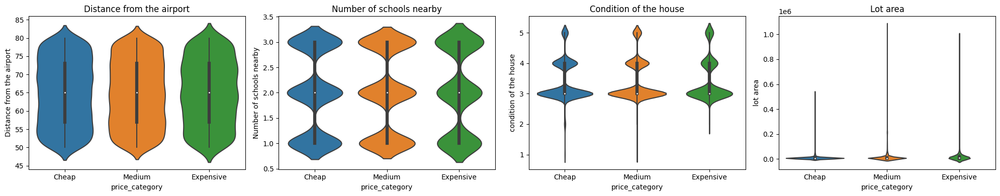

In [41]:
fig, axs = plt.subplots(1,4, figsize=(20,4))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Distance from the airport"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Number of schools nearby"], ax=axs[1])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["condition of the house"], ax=axs[2])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["lot area"], ax=axs[3])
axs[0].set_title('Distance from the airport')
axs[1].set_title('Number of schools nearby')
axs[2].set_title('Condition of the house')
axs[3].set_title('Lot area')

plt.tight_layout()

<h3>Dates</h3>

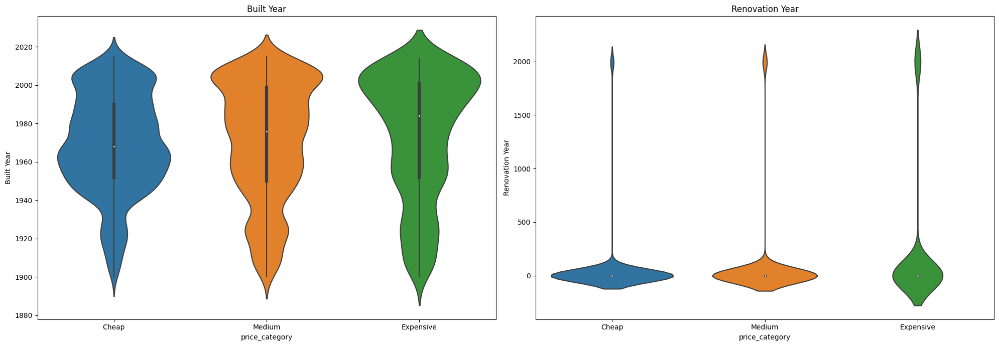

In [44]:
fig, axs = plt.subplots(1,2, figsize=(20,7))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Built Year"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Renovation Year"], ax=axs[1])
axs[0].set_title('Built Year')
axs[1].set_title('Renovation Year')

plt.tight_layout()

<h1>Is this really India though?</h1>

<h5>Location matters</h5>

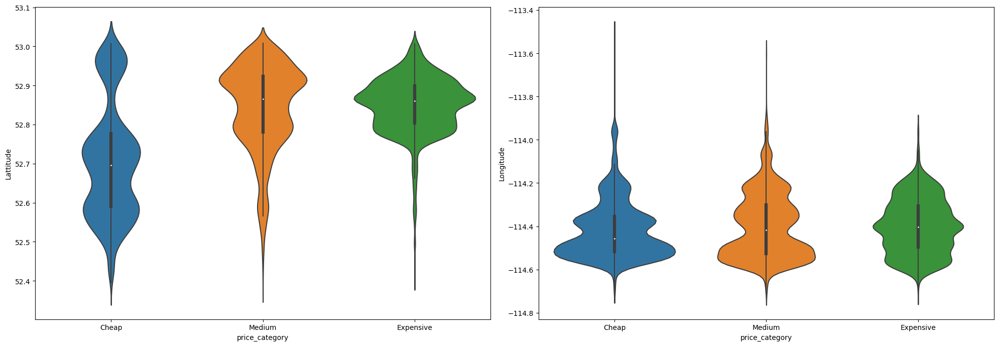

In [23]:
fig, axs = plt.subplots(1,2, figsize=(20,7))
axs = axs.flatten()

sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Lattitude"], ax=axs[0])
sns.violinplot(data=train_df, x=train_df["price_category"], y=train_df["Longitude"], ax=axs[1])

plt.tight_layout()

<div style="text-align:center;">
    <img src="location.png" alt="Houses location" height="500">
</div>

<h1>Trudności</h1>


<div style="display:flex;">
    <div style="flex:50%; padding: 0 10rem;">
        <img src="no_description.png" alt="Description of the image" style="height: 20rem">
    </div>
    <div style="flex:50%; padding: 2rem 10rem">
        <p>This table lacks variable descriptions. Because of that there is no way to tell for sure what "lot_area_renov" mean</p>
    </div>
</div>

![pairplot](pairplot.png)

<Figure size 3000x3000 with 0 Axes>

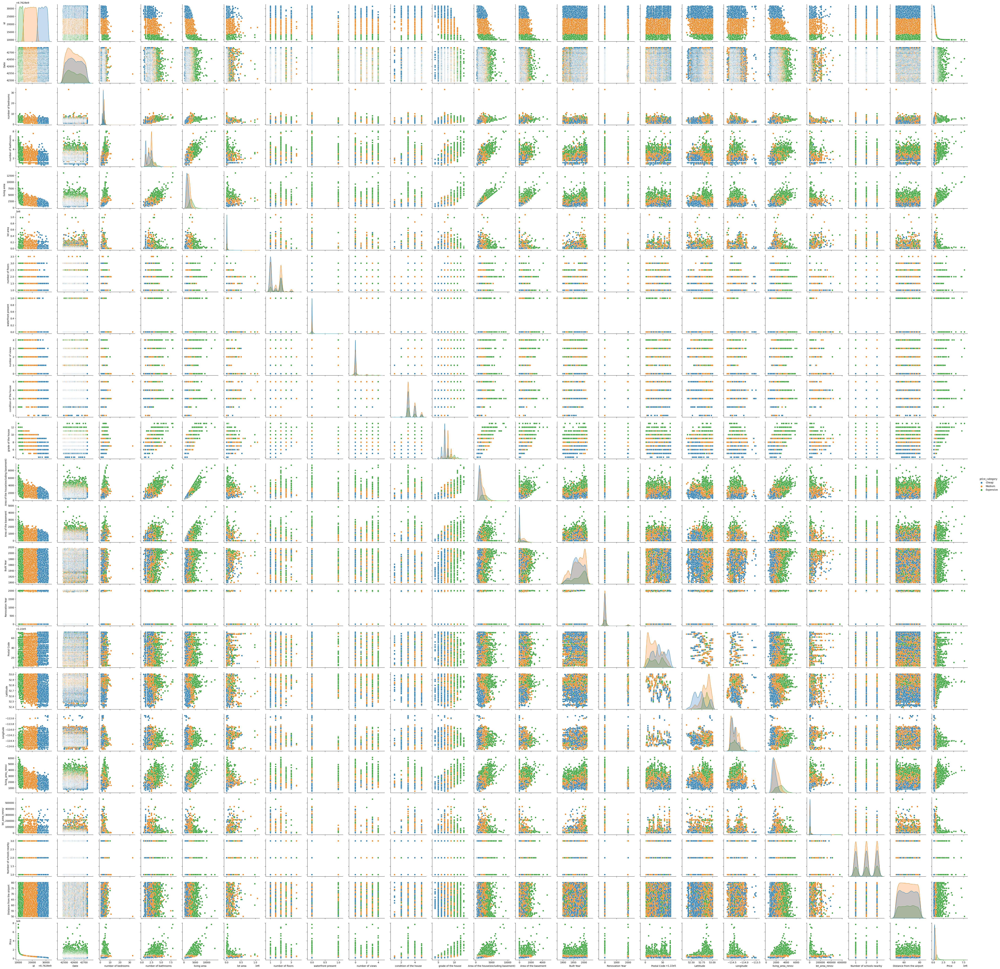

<Figure size 3000x3000 with 0 Axes>

In [24]:
sns.pairplot(data=houses_df, hue="price_category")
plt.figure(figsize=(30, 30))

In [8]:
from sklearn.tree import DecisionTreeClassifier, plot_tree


In [12]:
X_train=X_train.drop(['Price','price_category'],axis=1)

In [11]:
X_train=X_train.drop(['id','Date','lot area','waterfront present','condition of the house','Postal Code','Built Year','lot_area_renov','Number of schools nearby','Distance from the airport','Price','price_category'],axis=1)

KeyError: "['id', 'Date', 'lot area', 'waterfront present', 'condition of the house', 'Postal Code', 'Built Year', 'lot_area_renov', 'Number of schools nearby', 'Distance from the airport'] not found in axis"

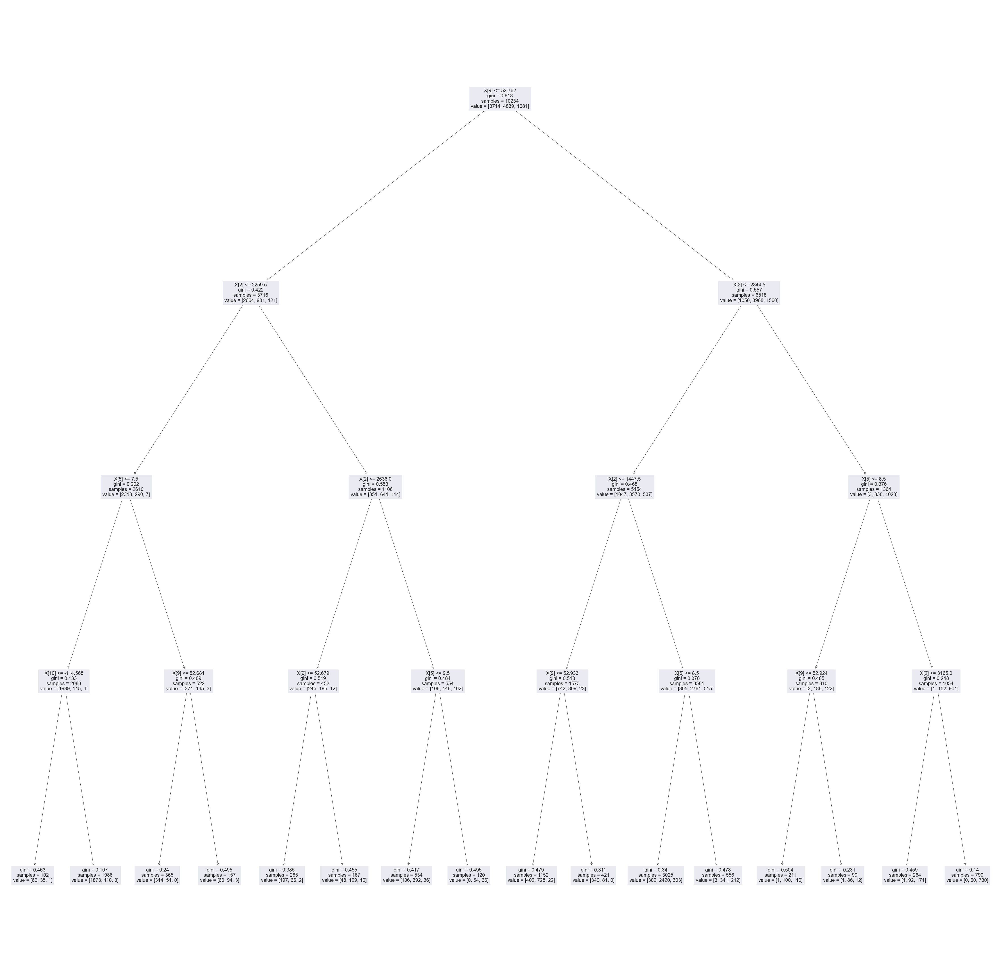

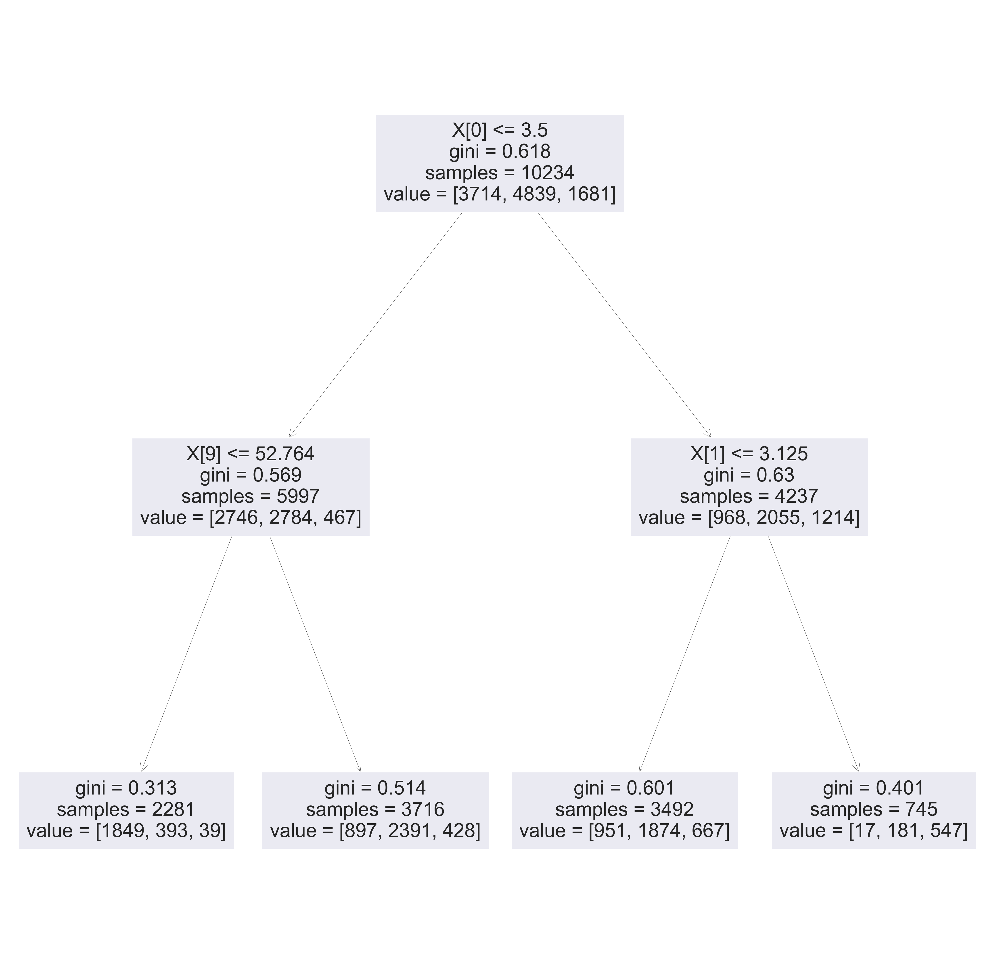

In [14]:
tree2 = DecisionTreeClassifier(max_depth=4)
tree2.fit(X_train, y_train)
plt.figure(figsize=(80, 80))
plot_tree(tree2)
plt.show()
tree3=DecisionTreeClassifier(max_depth=2,max_features=3)
tree3.fit(X_train, y_train)
plt.figure(figsize=(80, 80))
plot_tree(tree3)
plt.show()



In [16]:
from sklearn.metrics import accuracy_score

In [18]:
#X_test=X_test.drop(['id','Date','lot area','waterfront present','condition of the house','Postal Code','Built Year','lot_area_renov','Number of schools nearby','Distance from the airport','Price'],axis=1)
y2_pred=tree2.predict(X_test)
y3_pred=tree3.predict(X_test)
print(accuracy_score(y_test,y2_pred))
print(accuracy_score(y_test,y3_pred))

0.7794117647058824
0.6347469220246238


In [19]:
tree4=DecisionTreeClassifier(max_depth=7)
tree4.fit(X_train, y_train)
y4_pred=tree4.predict(X_test)
print(accuracy_score(y_test,y4_pred))

0.8129274965800274


In [20]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10234 entries, 2831 to 14422
Data columns (total 12 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   number of bedrooms                     10234 non-null  int64  
 1   number of bathrooms                    10234 non-null  float64
 2   living area                            10234 non-null  int64  
 3   number of floors                       10234 non-null  float64
 4   number of views                        10234 non-null  int64  
 5   grade of the house                     10234 non-null  int64  
 6   Area of the house(excluding basement)  10234 non-null  int64  
 7   Area of the basement                   10234 non-null  int64  
 8   Renovation Year                        10234 non-null  int64  
 9   Lattitude                              10234 non-null  float64
 10  Longitude                              10234 non-null  float64
 11 

In [22]:
X_train_sub1=X_train.drop(columns=['Renovation Year','Lattitude','Longitude','number of floors','number of views','living_area_renov'],axis=1)
X_test_sub1=X_test.drop(columns=['Renovation Year','Lattitude','Longitude','number of floors','number of views','living_area_renov'],axis=1)
tree5=DecisionTreeClassifier(max_depth=4)
tree5.fit(X_train_sub1,y_train)
y5_pred=tree5.predict(X_test_sub1)
print(accuracy_score(y_test,y5_pred))


0.6487688098495212


In [23]:
from sklearn.ensemble import VotingClassifier
estimators=[('tree3',tree3),('tree4',tree4),('tree5',tree5)]
model_ensemble1 = VotingClassifier(estimators=estimators, voting='hard')
model_ensemble1.fit(X_train_sub1,y_train)
y_e1=model_ensemble1.predict(X_test_sub1)
print(accuracy_score(y_test,y_e1))

0.6607387140902873


In [26]:
estimators2=[('tree3',tree3),('tree4',tree4)]
model_ensemble2 = VotingClassifier(estimators=estimators2, voting='hard')
model_ensemble2.fit(X_train,y_train)
y_e2=model_ensemble1.predict(X_test)
print(accuracy_score(y_test,y_e2))

C:\Users\DELL\anaconda3\lib\site-packages\sklearn\base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- Lattitude
- Longitude
- Renovation Year
- living_area_renov
- number of floors
- ...
Feature names must be in the same order as they were in fit.

  warnings.warn(message, FutureWarning)


ValueError: X has 12 features, but DecisionTreeClassifier is expecting 6 features as input.